## Differential gene expression analysis

For this second part, we will use DESeq2 to perform differential gene expression analysis. DESeq2 is ran in R. 

**Research question:** Which genes are differentially expressed between control and treatment cells?

## Part 1 - Prepare the data

In [1]:
setwd(paste0("/mnt/storage/r0913112/jupyternotebooks/Regulatory-Genomics/Task-1"))

#We will load the DESeq2 package into our R environment
library("DESeq2")

#Then, we will create a matrix with one row for each gene i and one column for each sample j
cts <- as.matrix(read.csv("counts/GSCs.counts.formatted", sep="\t", row.names = "Geneid"))
head(cts,5)

Loading required package: S4Vectors

Loading required package: stats4

Loading required package: BiocGenerics

Loading required package: parallel


Attaching package: ‘BiocGenerics’


The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find, get, grep,
    grepl, intersect, is.unsorted, lapply, Map, mapply, match, mget,
    order, paste, pmax, pmax.int, pmin, pmin.int, Position, rank,
    rbind, Reduce, rownames, sapply, setdiff, sort, table, tapply,
    union, unique, unsplit, which, which.max, which.min



Attaching package: ‘S4Vectors’


The

,GSC.040815.97.48h.1.Aligned.out.bam,GSC.040815.97.48h.2.Aligned.out.bam,GSC.040815.97.48h.3.Aligned.out.bam,GSC.040815.C1.Aligned.out.bam,GSC.040815.C2.Aligned.out.bam,GSC.040815.C3.Aligned.out.bam
DDX11L1,0,0,0,0,0,0
WASH7P,83,74,67,60,26,60
MIR6859-1,7,3,1,2,1,4
MIR1302-2HG,0,0,0,0,0,0
MIR1302-2,0,0,0,0,0,0


In [21]:
nrow(cts)

[1] 56505

In [2]:
#Then, we will create a dataframe with all the metadata of our experiment

metadata <- data.frame(
    row.names = c("GSC-040815-97-48h-1", "GSC-040815-97-48h-2", "GSC-040815-97-48h-3", "GSC-040815-C1","GSC-040815-C2","GSC-040815-C3"),
    condition = c("treatment","treatment","treatment","control","control","control"))
metadata

,condition
,<fct>
GSC-040815-97-48h-1,treatment
GSC-040815-97-48h-2,treatment
GSC-040815-97-48h-3,treatment
GSC-040815-C1,control
GSC-040815-C2,control
GSC-040815-C3,control


In [3]:
#It's necessary that the columns of the count matrix and the rows of the coldata have the same names
colnames(cts) <- c("GSC-040815-97-48h-1", "GSC-040815-97-48h-2", "GSC-040815-97-48h-3", "GSC-040815-C1","GSC-040815-C2","GSC-040815-C3")

After this, we will construct the DESeqDataSet (abbreviated as dds). For this we need:
- the count matrix (in our case, it's called cts)
- the metadata (the metadata, which is just the sample names and condition)
- the design, which variables to use to perform differential gene expression testing (condition)

In [4]:
suppressWarnings(library("DESeq2"))
dds <- DESeqDataSetFromMatrix(countData = cts,
                              colData = metadata,
                              design = ~ condition)
dds

class: DESeqDataSet 
dim: 56505 6 
metadata(1): version
assays(1): counts
rownames(56505): DDX11L1 WASH7P ... AC007325.4 AC007325.2
rowData names(0):
colnames(6): GSC-040815-97-48h-1 GSC-040815-97-48h-2 ... GSC-040815-C2
  GSC-040815-C3
colData names(1): condition

The order of the treatment and control group is set. The control group is the baseline, so it's set as the first level.

In [5]:
dds$condition <- factor(dds$condition, levels = c("control","treatment"))

It's good to do some pre-filtering to keep only the genes that have a count of at least 10 for at least 3 of the 6 samples

In [6]:
smallestGroupSize <- 3
keep <- rowSums(counts(dds) >= 10) >= smallestGroupSize
dds <- dds[keep,]

## Part 2 - Differential expression analysis
For illustrative purposes, the distribution of the expression of genes in sample GSC-040815-97-48h-1 is shown.

In [7]:
pdf("histogram1.pdf")
hist(cts[, 'GSC-040815-97-48h-1'], ylim=c(0, 200), col = "darkgray")
dev.off()

png 
  2

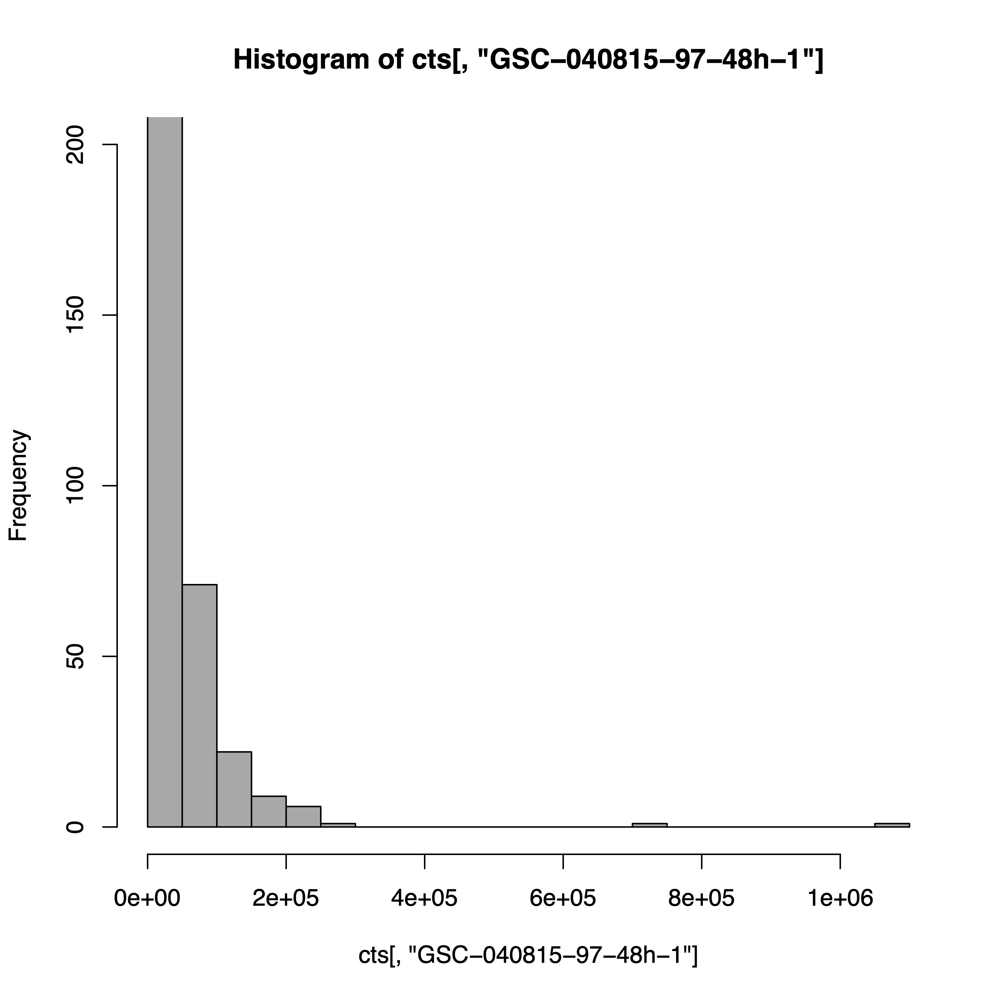

In [8]:
library(ggplot2)
data <- data.frame(
    mean = rowMeans(cts[rowSums(cts) != 0, ]),
    var  = rowVars(cts[rowSums(cts) != 0, ]))
pdf("ggplot1.pdf")
ggplot(data, aes(x = mean, y = var)) +
    geom_point() +
    scale_x_continuous(trans = "log10") +
    scale_y_continuous(trans = "log10") +
    geom_abline(intercept = 0, slope = 1, color = "red", size = 2)
dev.off()

Warning message:
“Using `size` aesthetic for lines was deprecated in ggplot2 3.4.0.
ℹ Please use `linewidth` instead.”
Warning message:
“Transformation introduced infinite values in continuous y-axis”


png 
  2

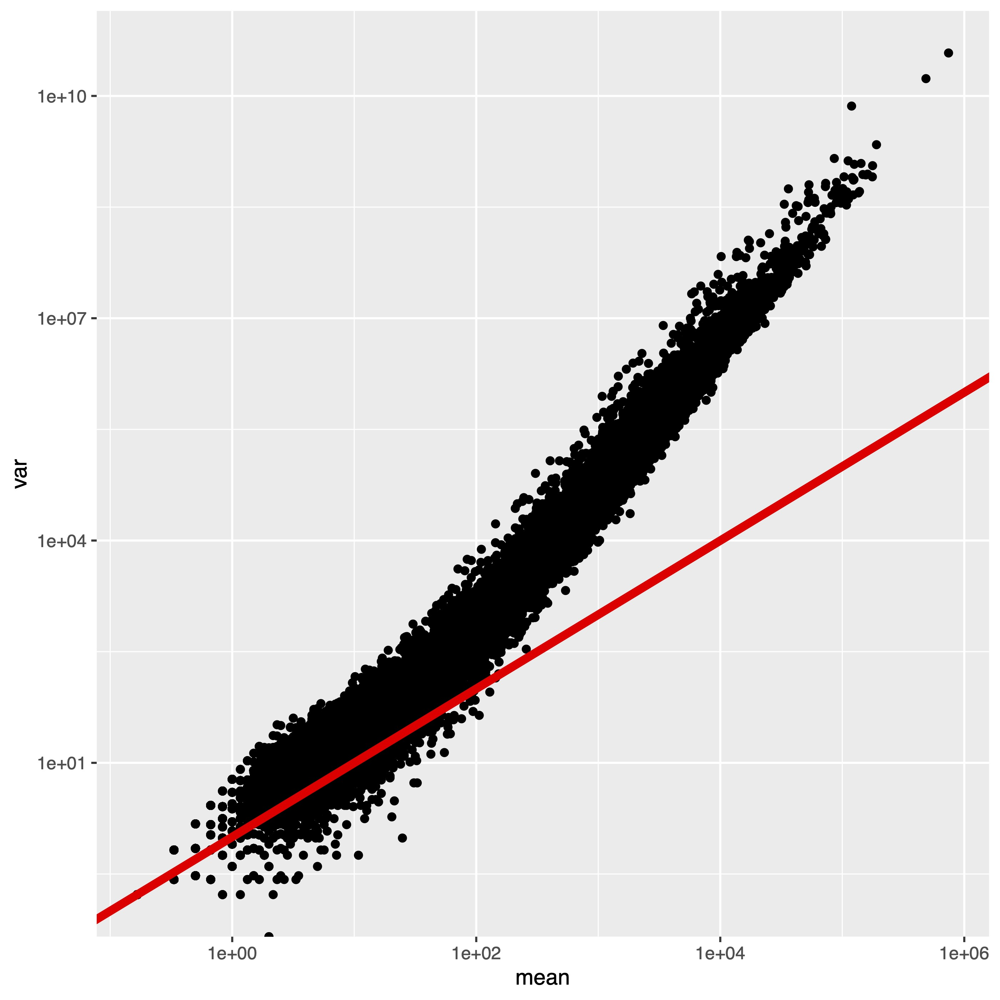

In [9]:
dds <- estimateSizeFactors(dds)
dds@colData

DataFrame with 6 rows and 2 columns
                    condition        sizeFactor
                     <factor>         <numeric>
GSC-040815-97-48h-1 treatment   1.3688140279404
GSC-040815-97-48h-2 treatment  1.07161085897399
GSC-040815-97-48h-3 treatment 0.880751821553896
GSC-040815-C1         control 0.968188607052949
GSC-040815-C2         control 0.793615108976361
GSC-040815-C3         control  1.02961526570887

In [10]:
dds <- estimateDispersions(dds)

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates



In [11]:
head(mcols(dds))

DataFrame with 6 rows and 10 columns
                      baseMean          baseVar   allZero         dispGeneEst
                     <numeric>        <numeric> <logical>           <numeric>
WASH7P         59.794964548904 217.847105533003     FALSE  0.0323496395545256
RP11-34P13.18 152.786142390382 416.866957194672     FALSE  0.0113980547731712
AP006222.2    10.7494880446476 10.9179036751143     FALSE               1e-08
MTND2P28      830.090925188535 77870.3234382462     FALSE 0.00709105544850319
MTCO1P12      144.376666936119 2826.48283421012     FALSE  0.0382307775771292
MTCO2P12      43.1474430515919 254.119829294302     FALSE  0.0289886588196694
              dispGeneIter             dispFit          dispersion  dispIter
                 <numeric>           <numeric>           <numeric> <integer>
WASH7P                   5  0.0400355777175257  0.0387510467623941         9
RP11-34P13.18            5  0.0159476699926642  0.0150055345916398         9
AP006222.2               2   0.

The data is better displayed as a Markdown Table: 

|                | baseMean          | baseVar          | allZero | dispGeneEst         | dispGeneIter | dispFit             | dispersion          | dispIter | dispOutlier | dispMAP             |
|----------------|-------------------|------------------|---------|---------------------|--------------|---------------------|---------------------|----------|-------------|---------------------|
| WASH7P         | 59.794964548904   | 217.847105533003 | FALSE   | 0.0323496395545256  | 5            | 0.0400355777175257  | 0.0387510467623941  | 9        | FALSE       | 0.0387510467623941  |
| RP11-34P13.18  | 152.786142390382  | 416.866957194672 | FALSE   | 0.0113980547731712  | 5            | 0.0159476699926642  | 0.0553054644705972  | 9        | FALSE       | 0.0150055345916398  |
| AP006222.2     | 10.7494880446476  | 10.9179036751143 | FALSE   | 1e-08               | 2            | 0.220608436317382   | 0.17886670768225    | 9        | FALSE       | 0.17886670768225    |
| MTND2P28       | 830.090925188535  | 77870.3234382462 | FALSE   | 0.00709105544850319 | 4            | 0.00330960980493761 | 0.00396097143976631 | 10       | FALSE       | 0.00396097143976631 |
| MTCO1P12       | 144.376666936119  | 2826.48283421012 | FALSE   | 0.0382307775771292  | 7            | 0.0168498513295161  | 0.0211238381346279  | 11       | FALSE       | 0.0211238381346279  |
| MTCO2P12       | 43.1474430515919  | 254.119829294302 | FALSE   | 0.0289886588196694  | 11           | 0.0553054644705972  | 0.0511484951259458  | 9        | FALSE       | 0.0511484951259458  |

In [12]:
pdf("ggplot2.pdf")
ggplot(as.data.frame(mcols(dds)[!mcols(dds)$allZero, ])) +
    geom_point(aes(x = baseMean, y = baseVar )) + 
    geom_line(aes(x = baseMean, y = baseMean + dispFit * baseMean * baseMean ), color = "red", size = 2) +
    scale_x_continuous(trans = "log10") +
    scale_y_continuous(trans = "log10")
dev.off()

png 
  2

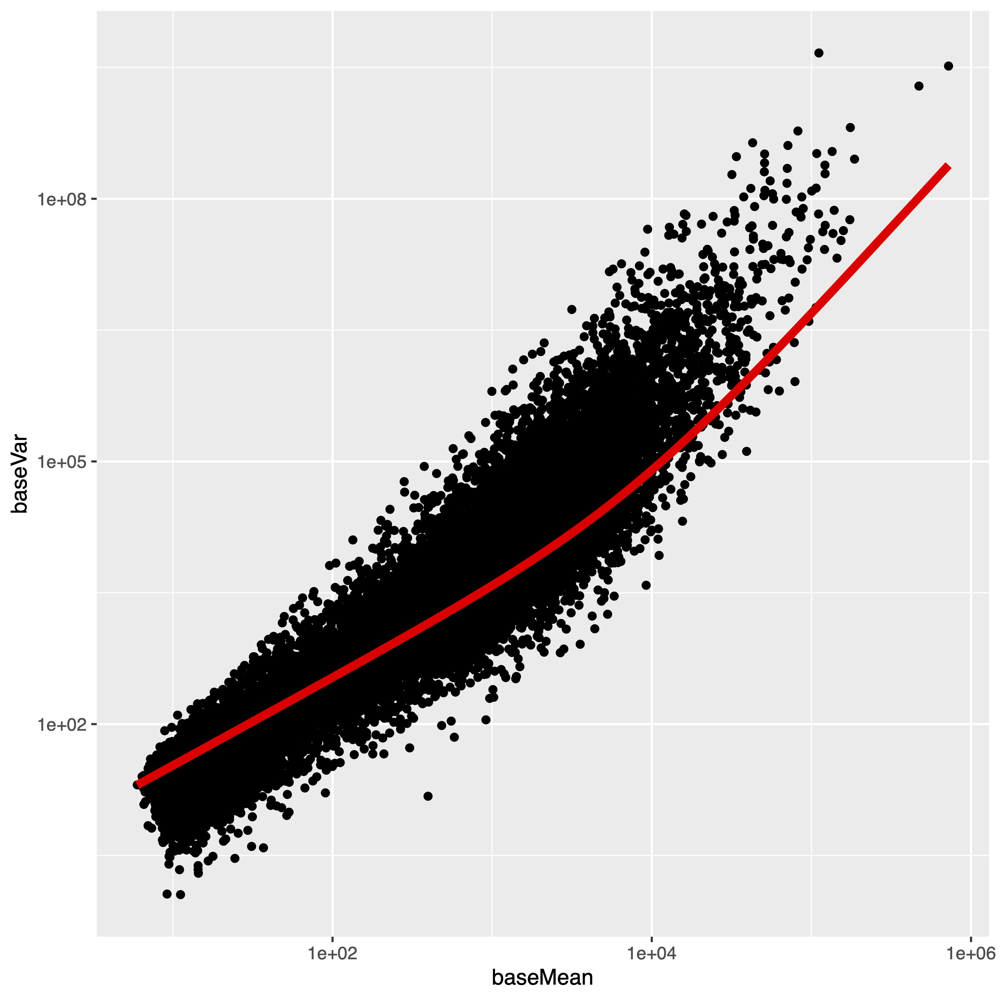

In [13]:
dds <- nbinomWaldTest(dds)
res <- results(dds)
res

log2 fold change (MLE): condition treatment vs control 
Wald test p-value: condition treatment vs control 
DataFrame with 15559 rows and 6 columns
                      baseMean      log2FoldChange              lfcSE
                     <numeric>           <numeric>          <numeric>
WASH7P         59.794964548904   0.407645562215211  0.278867583455035
RP11-34P13.18 152.786142390382    0.14395411773157  0.173191151663905
AP006222.2    10.7494880446476   0.220294176740581    0.6157547682142
MTND2P28      830.090925188535   0.897005391090248 0.0859712621453284
MTCO1P12      144.376666936119   0.838679266267884  0.200134159258021
...                        ...                 ...                ...
BX004987.1    17.6644842611598  -0.111066877502879   0.49754535808048
AC011043.1    136.100650715521 -0.0119724914017161  0.183834804458658
AL354822.1    11.7076898505326  -0.436987599526162  0.645958768111902
AL592183.1    153.251175435853  0.0067697446561226  0.180686309039266
AC240274.1   

The data is better displayed as a Markdown Table: 

|                | baseMean          | log2FoldChange      | lfcSE              | stat                | pvalue               | padj                 |
|----------------|-------------------|---------------------|--------------------|---------------------|----------------------|----------------------|
| WASH7P         | 59.794964548904   | 0.407645562215211   | 0.278867583455035  | 1.46178898660317    | 0.143799043044183    | 0.241463421447989    |
| RP11-34P13.18  | 152.786142390382  | 0.14395411773157    | 0.173191151663905  | 0.831186329951354   | 0.405868376065017    | 0.541076691217171    |
| AP006222.2     | 10.7494880446476  | 0.220294176740581   | 0.6157547682142    | 0.35776284344411    | 0.720520799167363    | 0.81156286107912     |
| MTND2P28       | 830.090925188535  | 0.897005391090248   | 0.0859712621453284 | 10.4337818092507    | 1.73829011132716e-25 | 4.34824048908992e-24 |
| MTCO1P12       | 144.376666936119  | 0.838679266267884   | 0.200134159258021  | 4.19058530226528    | 2.78235785163129e-05 | 0.00012146662686176  |
| BX004987.1     | 17.6644842611598  | -0.111066877502879  | 0.49754535808048   | -0.223229652732311  | 0.823356774617052    | 0.887472778438084    |
| AC011043.1     | 136.100650715521  | -0.0119724914017161 | 0.183834804458658  | -0.0651263586183895 | 0.948073393835521    | 0.971232152665715    |
| AL354822.1     | 11.7076898505326  | -0.436987599526162  | 0.645958768111902  | -0.676494570703715  | 0.498726691970976    | 0.630254109842139    |
| AL592183.1     | 153.251175435853  | 0.0067697446561226  | 0.180686309039266  | 0.0374668379254535  | 0.970112781074099    | 0.98357778969972     |
| AC240274.1     | 348.207009139519  | 0.684670169242535   | 0.12123305356536   | 5.64755360940746    | 1.62747094001168e-08 | 1.1125580121108e-07  |

In [14]:
#Everything of the previous cell can be run with just the command "DESeq2"
dds <- DESeq(dds)
res <- results(dds)
res

#Save the results as a tsv file for future analyses
write.table(res, "deseq.results.tsv", sep="\t", col.names=NA, quote=FALSE)

#We will add this file to the functional-analysis-gene-signatures directory in our master folder (Task-1)

using pre-existing size factors

estimating dispersions

found already estimated dispersions, replacing these

gene-wise dispersion estimates

mean-dispersion relationship

final dispersion estimates

fitting model and testing



log2 fold change (MLE): condition treatment vs control 
Wald test p-value: condition treatment vs control 
DataFrame with 15559 rows and 6 columns
                      baseMean      log2FoldChange              lfcSE
                     <numeric>           <numeric>          <numeric>
WASH7P         59.794964548904   0.407645562215211  0.278867583455035
RP11-34P13.18 152.786142390382    0.14395411773157  0.173191151663905
AP006222.2    10.7494880446476   0.220294176740581    0.6157547682142
MTND2P28      830.090925188535   0.897005391090248 0.0859712621453284
MTCO1P12      144.376666936119   0.838679266267884  0.200134159258021
...                        ...                 ...                ...
BX004987.1    17.6644842611598  -0.111066877502879   0.49754535808048
AC011043.1    136.100650715521 -0.0119724914017161  0.183834804458658
AL354822.1    11.7076898505326  -0.436987599526162  0.645958768111902
AL592183.1    153.251175435853  0.0067697446561226  0.180686309039266
AC240274.1   

In [15]:
pdf("ggplot3.pdf")
ggplot(as.data.frame(res), aes(x = baseMean, y = log2FoldChange)) +
    geom_point(aes(colour = padj < 0.01), size = 0.5) +
    scale_x_continuous(trans = "log10") +
    scale_color_manual(name = "padj < 0.01", values = setNames(c("red", "black"), c(T, F)))
dev.off()

png 
  2

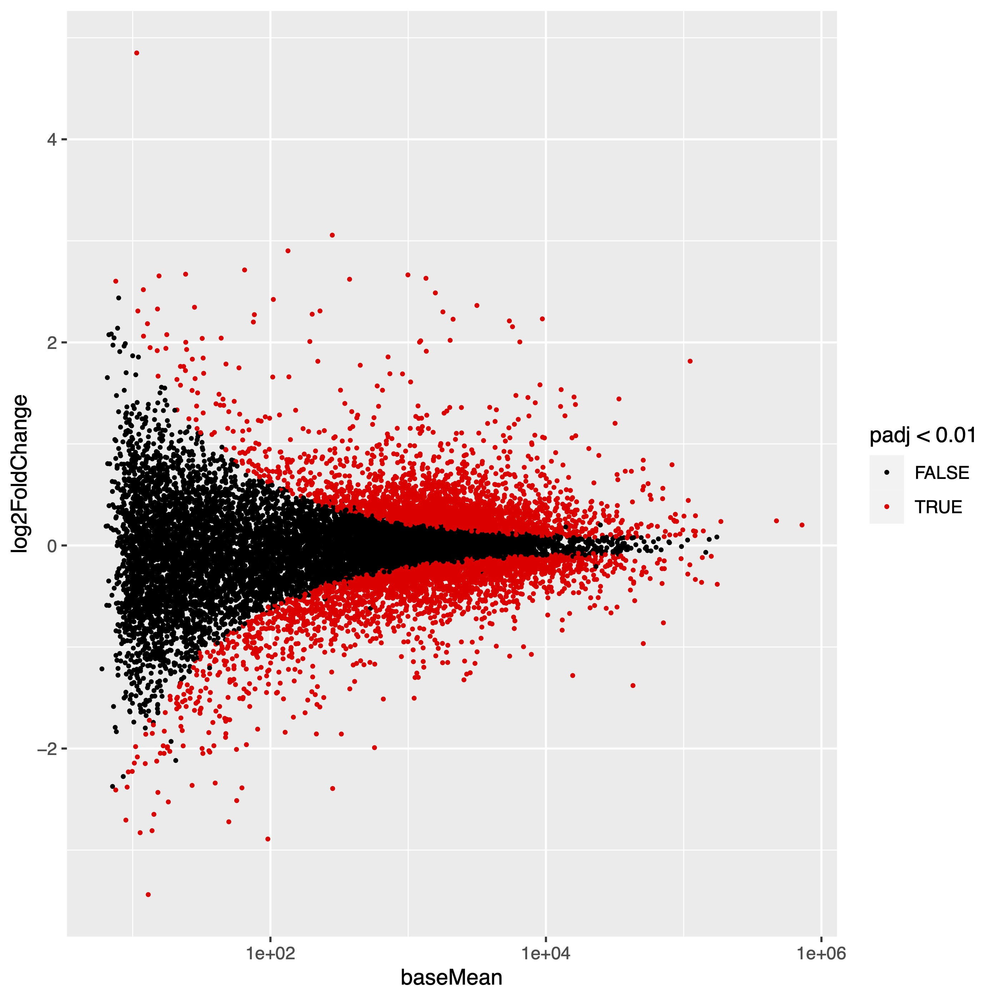

In [16]:
pdf("ggplot4.pdf")
ggplot(as.data.frame(res), aes(x = baseMean, y = lfcSE)) +
    geom_point(size = 0.5) +
    scale_x_continuous(trans = "log10") +
    ylim(0, 3)
dev.off()

png 
  2

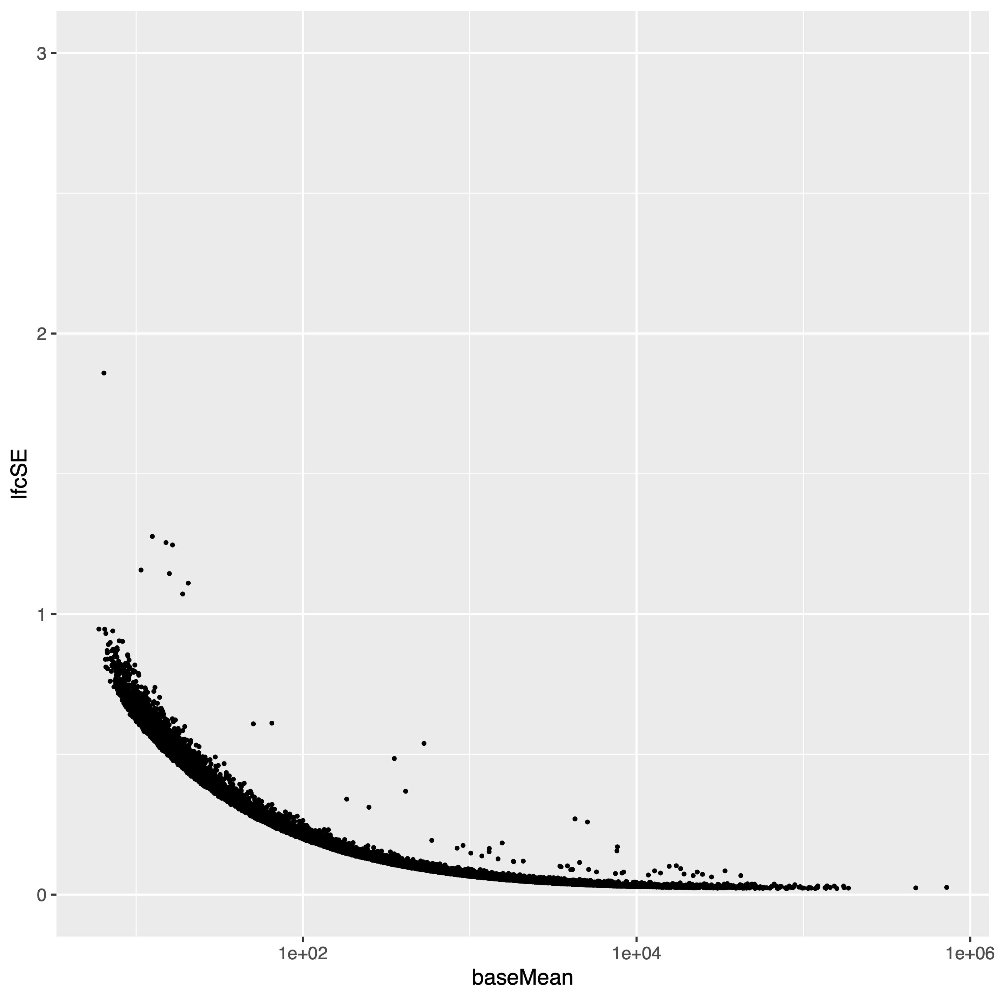

In [17]:
#Shrinking condition_treatment_vs_control 
resultsNames(dds)
resLFC <- lfcShrink(dds, coef="condition_treatment_vs_control")
resLFC

pdf("ggplot5.pdf")
ggplot(as.data.frame(resLFC), aes(x = baseMean, y = log2FoldChange)) +
    geom_point(aes(colour = padj < 0.01), size = 0.5) +
    scale_x_continuous(trans = "log10") +
    scale_color_manual(name = "padj < 0.01", values = setNames(c("red", "black"), c(T, F)))
dev.off()

[1] "Intercept"                      "condition_treatment_vs_control"

using 'normal' for LFC shrinkage, the Normal prior from Love et al (2014).

Note that type='apeglm' and type='ashr' have shown to have less bias than type='normal'.
See ?lfcShrink for more details on shrinkage type, and the DESeq2 vignette.
Reference: https://doi.org/10.1093/bioinformatics/bty895



log2 fold change (MAP): condition treatment vs control 
Wald test p-value: condition treatment vs control 
DataFrame with 15559 rows and 6 columns
                      baseMean      log2FoldChange              lfcSE
                     <numeric>           <numeric>          <numeric>
WASH7P         59.794964548904    0.23055712065845  0.157508815092597
RP11-34P13.18 152.786142390382     0.1110027873426  0.133515345410736
AP006222.2    10.7494880446476  0.0463852792288629  0.129675346070737
MTND2P28      830.090925188535   0.835793748154597 0.0800230344313491
MTCO1P12      144.376666936119    0.60077618268655  0.143018435382766
...                        ...                 ...                ...
BX004987.1    17.6644842611598   -0.03227094651436  0.144162696806803
AC011043.1    136.100650715521 -0.0089714324736539  0.137748183722702
AL354822.1    11.7076898505326 -0.0849609497421814  0.125965054217802
AL592183.1    153.251175435853 0.00511971355613105  0.136549917148695
AC240274.1   

png 
  2

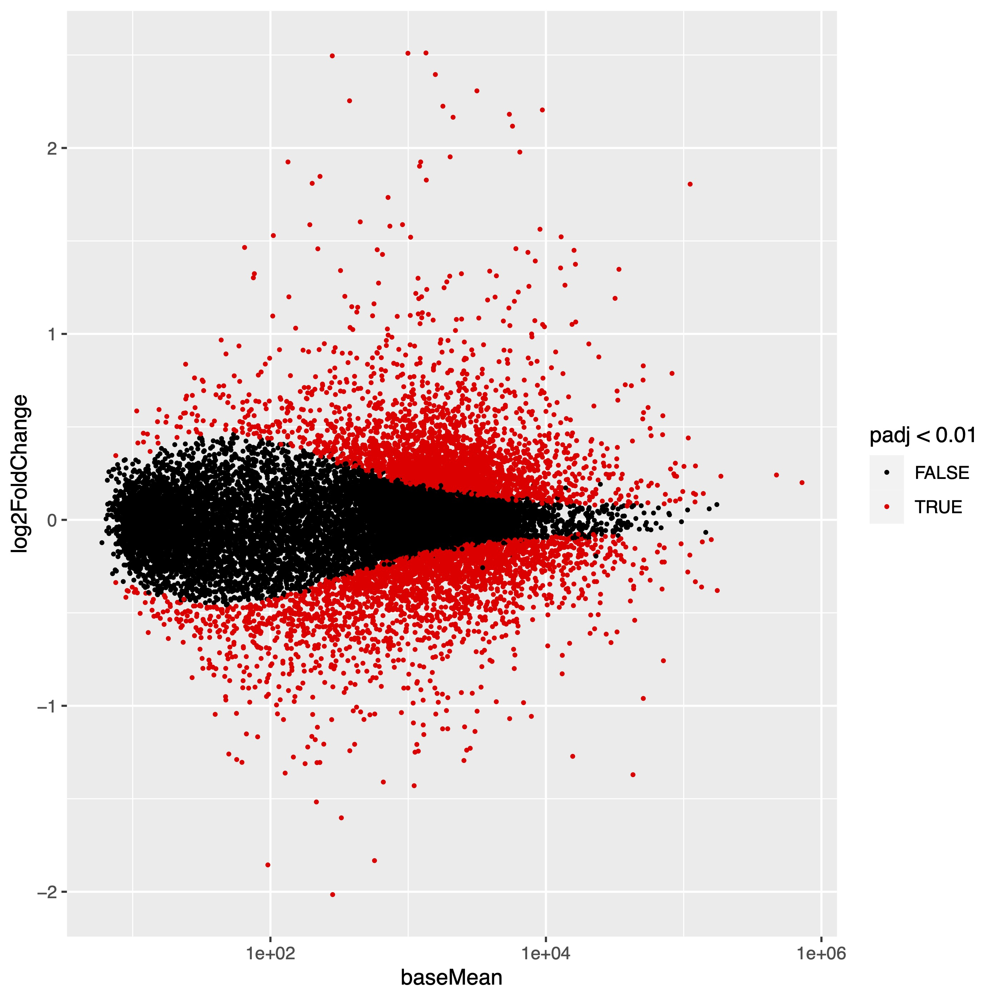

In [18]:
pdf("ggplot6.pdf")
ggplot(as.data.frame(resLFC), aes(x = baseMean, y = lfcSE)) +
    geom_point(size = 0.5) +
    scale_x_continuous(trans = "log10") +
    ylim(0, 3)
dev.off()

png 
  2

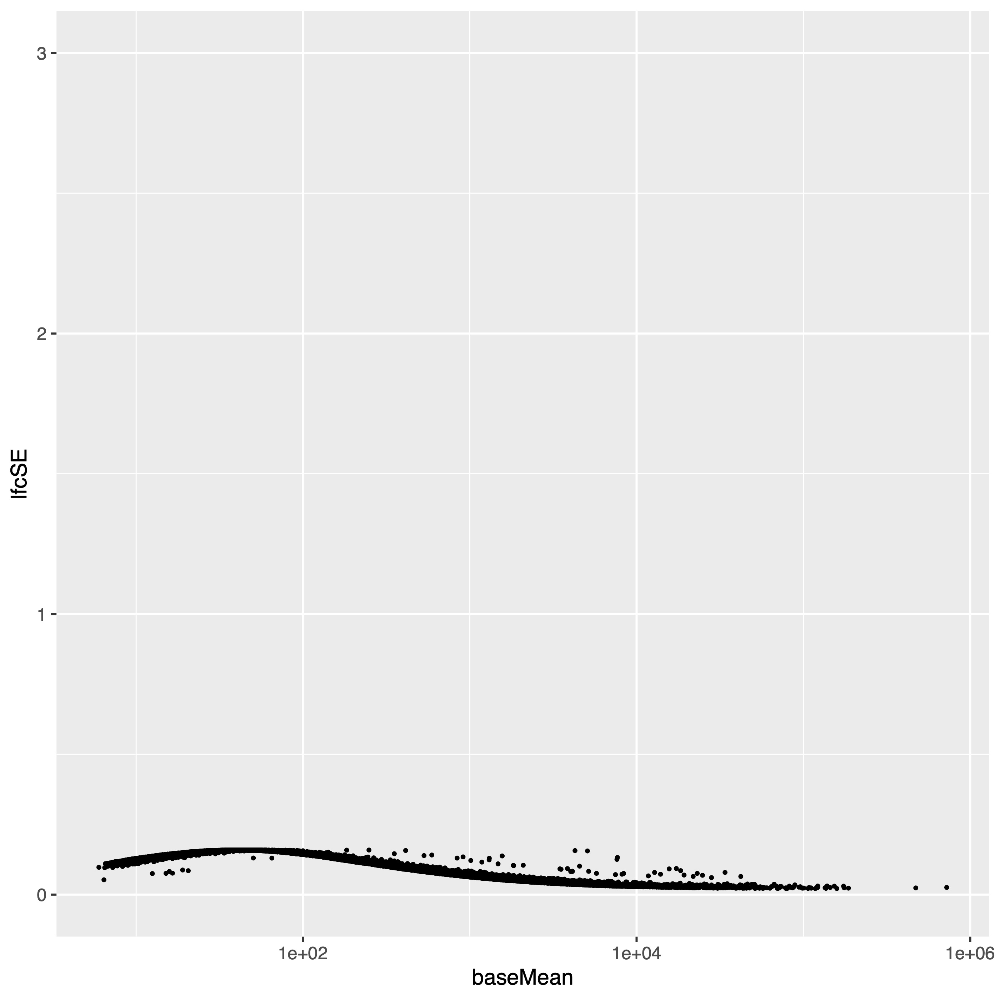

## Part 3 - Downstream analysis

In [19]:
library(dplyr)
suppressWarnings(library(dplyr))

resLFC_df <- as.data.frame(resLFC)

#Defining tresholds
log2FC_thr = 1
pad_thr = 0.01

#Upregulated genes
upregulated_genes <- row.names(resLFC_df %>% 
    filter(log2FoldChange > log2FC_thr, padj < pad_thr))

#Downregulated genes
downregulated_genes <- row.names(resLFC_df %>% 
    filter(log2FoldChange < log2FC_thr, padj < pad_thr))

#The list is sorted based on the log2 of the fold change 
resLFC_df %>%
    arrange(log2FoldChange)


Attaching package: ‘dplyr’


The following object is masked from ‘package:matrixStats’:

    count


The following object is masked from ‘package:Biobase’:

    combine


The following objects are masked from ‘package:GenomicRanges’:

    intersect, setdiff, union


The following object is masked from ‘package:GenomeInfoDb’:

    intersect


The following objects are masked from ‘package:IRanges’:

    collapse, desc, intersect, setdiff, slice, union


The following objects are masked from ‘package:S4Vectors’:

    first, intersect, rename, setdiff, setequal, union


The following objects are masked from ‘package:BiocGenerics’:

    combine, intersect, setdiff, union


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




,baseMean,log2FoldChange,lfcSE,stat,pvalue,padj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
HBBP1,282.89576,-2.015398,0.11451524,-17.263037,8.928864e-67,7.718011e-65
MIR210HG,95.79595,-1.855749,0.14968230,-11.807487,3.570761e-32,1.162290e-30
HLA-DRA,569.61069,-1.832628,0.08569922,-21.226791,5.402768e-100,8.241340e-98
SERPINB7,327.24555,-1.602548,0.10850204,-14.650409,1.339072e-48,7.467604e-47
RP13-463N16.6,215.58717,-1.517120,0.12192530,-12.304429,8.574022e-35,3.088037e-33
APLN,1104.81007,-1.429802,0.06876343,-20.754167,1.124126e-95,1.665741e-93
HLA-DRB1,660.18245,-1.410051,0.07977214,-17.619956,1.731401e-69,1.575372e-67
COL1A1,42846.98161,-1.370614,0.02577718,-53.169681,0.000000e+00,0.000000e+00
WNT7B,127.88589,-1.361915,0.13833753,-9.704956,2.872006e-22,5.942225e-21


In [20]:
#With the pheatmap package, we will plot a heatmap of the up- and downregulated genes
library(pheatmap)
pdf("heatmap1.pdf")
pheatmap(cts[c(upregulated_genes, downregulated_genes), ], scale = "row", show_rownames = F)
dev.off()

pdf 
  3

We can observe the resulting heatmap down below:
